## Visualize WoFCast Predictions

In [1]:
import os
os.environ['XLA_PYTHON_CLIENT_PREALLOCATE'] = 'true'
os.environ['XLA_PYTHON_CLIENT_MEM_FRACTION'] = '0.95'

import sys
sys.path.insert(0, os.path.dirname(os.path.dirname(os.getcwd())))

from wofscast.model import WoFSCastModel
from wofscast.border_mask import BORDER_MASK_NUMPY
from wofscast import rollout 

from wofscast.data_generator import (load_chunk, 
                                     WRFZarrFileProcessor,
                                     WoFSDataProcessor, 
                                     dataset_to_input,
                                     add_local_solar_time
                                    )
from wofscast import checkpoint
from wofscast.wofscast_task_config import (DBZ_TASK_CONFIG, 
                                           WOFS_TASK_CONFIG, 
                                           DBZ_TASK_CONFIG_1HR,
                                           DBZ_TASK_CONFIG_FULL
                                          )

from wofscast.model_utils import dataset_to_stacked

In [2]:
# For plotting. 
import os
import numpy as np
import xarray 
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from mpl_toolkits.axes_grid1 import make_axes_locatable

from wofscast.plot import WoFSColors, WoFSLevels
from datetime import datetime
import pandas as pd

def get_start_time(path):
    name, freq, ens_mem = os.path.basename(path).split('__')
    start_time_dt = datetime.strptime(name.split('_to')[0], 'wrfwof_%Y-%m-%d_%H%M%S')
    start_time = pd.Timestamp(start_time_dt)
    
    return start_time


def to_datetimes(path, n_times = 13):  
    name, freq, ens_mem = os.path.basename(path).split('__')
    start_time_dt = datetime.strptime(name.split('_to')[0], 'wrfwof_%Y-%m-%d_%H%M%S')
    start_time = pd.Timestamp(start_time_dt)
    
    dt_list = pd.date_range(start=start_time, periods=n_times, freq=freq)
    
    # Remove the first 2 time steps, since those aren't plotted 
    # as they are used as the initial input. 
    return dt_list[2:]

# Assuming 'BORDER_MASK' is available and correctly sized for your 'preds' and 'tars'
def border_difference_check(preds, tars, border_mask):
    """Calculate the difference at the border and return a mask of differences."""
    border_diff = np.abs(preds - tars)
    # Apply the border mask to get differences only at the border
    border_diff_masked = np.where(border_mask, border_diff, np.nan)  # NaN where not border
    return np.nanmax(border_diff_masked)  # Get the maximum difference at the border

display_name_mapper = {'U' : 'U-wind Comp.', 
          'V' : 'V-wind Comp.', 
          'W' : 'Vert. Velocity',
          'T' : 'Pot. Temp.', 
          'GEOPOT' : 'Geopot. Height',
          'QVAPOR' : 'QVAPOR', 
          'T2' : '2-m Temp.', 
          'COMPOSITE_REFL_10CM' : 'Comp. Refl.',
          'UP_HELI_MAX' : '2-5 km UH', 
          'RAIN_AMOUNT' : 'Rain Rate'
         }

units_mapper = {'T': 'K', 
                'QVAPOR': 'kg/kg', 
                'T2': 'K', 
                'U': 'm/s', 
                'V': 'm/s', 
                'W': 'm/s', 
                'GEOPOT': 'm', 
                'RAIN_AMOUNT': 'in', 
                'COMPOSITE_REFL_10CM': 'dBZ'
               }

## Predict with WoFS-Cast

In [3]:
use_raw_zarr = False 
import xarray as xr

if use_raw_zarr: 

    base_path = '/work2/wofs_zarr/2021/20210503/2300/ENS_MEM_07'
    zarr_files = [os.path.join(base_path, f) for f in os.listdir(base_path)]
    zarr_files.sort()

    zarr_files = [zarr_files[::2][:14]]
    
    process_fn = preprocessor = WoFSDataProcessor()
    dataset = load_chunk(zarr_files, batch_over_time=True, gpu_batch_size=32, preprocess_fn=process_fn)
    
    dataset = dataset.compute()
else:
    base_path = '/work/mflora/wofs-cast-data/datasets_2hr_zarr/2021'

    # no storms. 
    #name = 'wrfwof_2021-05-14_200000_to_2021-05-14_221000__10min__ens_mem_05.zarr'
    
    # clean-ish supercell environ.
    name = 'wrfwof_2021-05-13_200000_to_2021-05-13_221000__10min__ens_mem_09.zarr'
    
    # Commonly shown case.
    #name = 'wrfwof_2021-05-15_020000_to_2021-05-15_041000__10min__ens_mem_09.zarr'
    
    #name = 'wrfwof_2021-05-30_220000_to_2021-05-31_001000__10min__ens_mem_06.zarr'
    
    #name = 'wrfwof_2021-05-29_000000_to_2021-05-29_021000__10min__ens_mem_03.zarr'
    
    #name = 'wrfwof_2021-05-29_000000_to_2021-05-29_021000__10min__ens_mem_04.zarr'
    
    path = os.path.join(base_path, name)
    
    def preprocess_fn(dataset):
        #_path = '/work/mflora/wofs-cast-data/datasets_zarr/2021/'
        #latlon_path = os.path.join(_path, 'wrfwof_2021-05-15_040000_to_2021-05-15_043000__10min__ens_mem_09.zarr')
        #preprocess_fn = WoFSDataProcessor(latlon_path=latlon_path)
        
        #dataset = preprocess_fn(dataset)
        
        dataset = add_local_solar_time(dataset) 
        
        return dataset 
    
    dataset = load_chunk([path], 1, preprocess_fn)
    dataset = dataset.compute() 


In [4]:
import xarray as xr
import numpy as np

def insert_warm_bubble(dataset, center, horizontal_radius, vertical_radius, temperature_reduction):
    """
    Inserts a cold bubble into the dataset.
    
    Parameters:
    - dataset: xarray.Dataset with dimensions (time, z, y, x)
    - center: tuple of (time_idx, z_idx, y_idx, x_idx) indicating the center of the bubble
    - horizontal_radius: radius of the bubble in the horizontal plane (y, x)
    - vertical_radius: radius of the bubble in the vertical direction (z)
    - temperature_reduction: temperature reduction value
    
    Returns:
    - xarray.Dataset with the cold bubble inserted
    """
    time_idx, z_idx, y_idx, x_idx = center
    
    # Define the ranges for the bubble
    z_min = max(z_idx - vertical_radius, 0)
    z_max = min(z_idx + vertical_radius + 1, dataset.dims['level'])
    
    y_min = max(y_idx - horizontal_radius, 0)
    y_max = min(y_idx + horizontal_radius + 1, dataset.dims['lat'])
    
    x_min = max(x_idx - horizontal_radius, 0)
    x_max = min(x_idx + horizontal_radius + 1, dataset.dims['lon'])
    
    # Create a mask for the bubble
    z_range = np.arange(z_min, z_max)
    y_range = np.arange(y_min, y_max)
    x_range = np.arange(x_min, x_max)
    
    bubble_mask = np.zeros_like(dataset['T'].isel(time=time_idx).values, dtype=bool)
    for z in z_range:
        for y in y_range:
            for x in x_range:
                distance = np.sqrt(((z - z_idx) / vertical_radius) ** 2 + 
                                   ((y - y_idx) / horizontal_radius) ** 2 + 
                                   ((x - x_idx) / horizontal_radius) ** 2)
                if distance <= 1:
                    # shape = (batch, lat, lon, level)
                    bubble_mask[0,y,x,z] = True
    
    # Apply the temperature reduction
    dataset_cp = dataset.copy()
    
    temp_data = dataset['T'].isel(time=time_idx).values
    temp_data[bubble_mask] += temperature_reduction
    dataset_cp['T'].values[time_idx] = temp_data
    
    return dataset_cp

In [15]:
%%time 
# Corey's biggest model 
MODEL_PATH = '/work/cpotvin/WOFSCAST/model/wofscast_test_v178.npz'

#MODEL_PATH = '/work/mflora/wofs-cast-data/model/wofscast_10min_model_noise_v1.npz'


model = WoFSCastModel()
 
model.load_model(MODEL_PATH, )

inputs, targets, forcings = dataset_to_input(dataset, model.task_config, 
                                             target_lead_times=slice('10min', '110min'), 
                                             #target_lead_times=slice('1hr', '4hr'),
                                             batch_over_time=False, n_target_steps=2)


extended_targets = rollout.extend_targets_template(targets, required_num_steps=12)

initial_datetime = get_start_time(path)
# Create the new datetime coordinate by adding the timedeltas to the initial datetime
datetime_coord = initial_datetime + extended_targets['time'].data

# Assign the new datetime coordinate to the dataset
extended_targets = extended_targets.assign_coords(datetime=datetime_coord)

extended_forcings = add_local_solar_time(extended_targets.copy())
extended_forcings = extended_forcings[model.task_config.forcing_variables]
extended_forcings = extended_forcings.expand_dims('batch', axis=0)

extended_forcings = extended_forcings.drop_vars('datetime', errors='ignore')
extended_targets = extended_targets.drop_vars('datetime', errors='ignore')

# Add a warm bubble. 
cold_bubble_center = (0, 5, 75, 75)  # Example center coordinates
horizontal_radius = 20
vertical_radius = 4
temperature_reduction = 7.0  # Example temperature reduction in K

#'''
inputs = insert_warm_bubble(inputs, 
                                cold_bubble_center, 
                                horizontal_radius, 
                                vertical_radius, 
                                temperature_reduction)
#'''
predictions = model.predict(inputs, extended_targets, extended_forcings, replace_bdry=False)
#predictions = model.predict(inputs, targets, forcings, replace_bdry=False)

CPU times: user 26.4 s, sys: 212 ms, total: 26.6 s
Wall time: 3.67 s


In [17]:

class WoFSCastAnimator:
    def __init__(self, domain_size, plot_border=False, dts=None):
        self.dts = dts  # Placeholder, replace with your datetime conversion function
        self.plot_border = plot_border
        self.domain_size = domain_size
    
    def __call__(self, var, level, inputs, predictions, targets, mrms_dz=None):
        self.var = var
        self.level = level
        self.inputs = inputs
        self.predictions = predictions
        self.targets = targets
        self.mrms_dz = mrms_dz
    
        init_ds, pred, tars = self.drop_batch_dim(inputs, predictions, targets)
    
        level_txt = ''
        if level != 'none': 
            level_txt = f', level={level}'
    
        self.titles = [f'WoFS {display_name_mapper.get(var, var)}{level_txt}', 
                       f'WoFS-Cast {display_name_mapper.get(var, var)}{level_txt}']
    
        fig, self.axes = plt.subplots(dpi=200, figsize=(12, 6), ncols=2, 
                                      gridspec_kw={'height_ratios': [1], 'bottom': 0.15})
        
        plt.tight_layout()
    
        zs, levels = self.get_target_and_pred_pair(init_ds, init_ds, t=0, level=level, return_rng=True)
    
        self.cmap, self.levels = self.get_colormap_and_levels(var, levels)
    
        self.cbar_ax = fig.add_axes([0.15, 0.075, 0.7, 0.02])
        self.cbar = None
        
        self.fig = fig
        self.N = len(predictions.time)
    
        return FuncAnimation(fig, self.update, frames=self.N, interval=200)
    
    def drop_batch_dim(self, inputs, predictions, targets):
        dims = ('time', 'level', 'lat', 'lon')
        init_ds = inputs.squeeze(dim='batch', drop=True).isel(time=[-1]).transpose(*dims, missing_dims='ignore')
        preds = predictions.squeeze(dim='batch', drop=True).transpose(*dims, missing_dims='ignore')
        tars = targets.squeeze(dim='batch', drop=True).transpose(*dims, missing_dims='ignore')
    
        return init_ds, preds, tars
    
    def get_target_and_pred_pair(self, preds, targets, t, level=0, return_rng=False):
        max_t = len(targets.time) - 1
        target_t = max_t
        if t < max_t:
            target_t = t
            
        
        if level == 'max':
            zs = [targets[self.var].isel(time=target_t).max(dim='level').values, 
                  preds[self.var].isel(time=t).max(dim='level').values]
        elif level == 'min': 
            zs = [targets[self.var].isel(time=target_t).min(dim='level').values, 
                  preds[self.var].isel(time=t).min(dim='level').values]
        elif level == 'none':
            zs = [targets[self.var].isel(time=target_t).values, 
                  preds[self.var].isel(time=t).values]
        else:
            zs = [targets[self.var].isel(time=target_t, level=level).values, 
                  preds[self.var].isel(time=t, level=level).values]
    
        if self.var == 'RAIN_AMOUNT':
            zs = [z / 25.4 for z in zs]
    
        if self.var == 'T2':
            zs = [(9.0 / 5.0 * (z - 273.15)) + 32.0 for z in zs]
    
        if return_rng:
            global_min = np.percentile(zs, 1)
            global_max = np.percentile(zs, 99)
            rng = np.linspace(global_min, global_max, 10)
            return zs, rng
    
        return zs 
    
    def get_colormap_and_levels(self, var, levels):
        if var == 'COMPOSITE_REFL_10CM':
            cmap = WoFSColors.nws_dz_cmap
            levels = WoFSLevels.dz_levels_nws
        elif var == 'RAIN_AMOUNT':
            cmap = WoFSColors.rain_cmap
            levels = WoFSLevels.rain_rate_levels
        elif var == 'UP_HELI_MAX':
            cmap = WoFSColors.wz_cmap_extend
            levels = WoFSLevels.uh_2to5_levels_3000m
        elif var == 'T2':
            cmap = WoFSColors.temp_cmap
            levels = np.arange(40., 90., 2.5)
        elif var == 'QVAPOR': 
            cmap = WoFSColors.temp_cmap
        elif var == 'W': 
            cmap = WoFSColors.wz_cmap_extend
            levels = [2.5, 5, 10, 15, 20, 25, 30, 35, 40]
        else:
            cmap = WoFSColors.wz_cmap_extend
        
        return cmap, levels
    
    def update(self, t):
        for ax in self.axes:
            ax.clear()

        if t == 0:
            zs = self.get_target_and_pred_pair(self.inputs, self.inputs, t=0, level=self.level)
        else:    
            zs = self.get_target_and_pred_pair(self.predictions, self.targets, t=t, level=self.level)
    
        rmse = np.sqrt(np.mean((zs[0] - zs[1])**2))

        try:
            u_pred, v_pred = self.predictions['U'][t].isel(level=0).values, self.predictions['V'][t].isel(level=0).values
            u_tar, v_tar = self.targets['U'][t].isel(level=0).values, self.targets['V'][t].isel(level=0).values 
            u_pred = u_pred[::5, ::5]
            v_pred = v_pred[::5, ::5]
            u_tar = u_tar[::5, ::5]
            v_tar = v_tar[::5, ::5]
            wind_pred = (u_pred, v_pred)
            wind_tar = (u_tar, v_tar)
            winds = [wind_tar, wind_pred]
            x, y = np.meshgrid(np.arange(self.domain_size), np.arange(self.domain_size))
            x = x[::5, ::5]
            y = y[::5, ::5]
        except:
            winds = [None, None]
    
        for i, (ax, z, wind) in enumerate(zip(self.axes, zs, winds)):
            
            z = z.squeeze() 
            
            if self.var in ['REFL_10CM', 'UP_HELI_MAX', 'COMPOSITE_REFL_10CM']:
                z = np.ma.masked_where(z < 1, z)

            im = ax.contourf(z, origin='lower', aspect='equal', cmap=self.cmap, levels=self.levels)
 
            try:
                u, v = wind
                ax.quiver(x, y, u, v, alpha=0.5)
            except:
                pass

            ax.set_title(self.titles[i], fontweight='bold')
            if i == 1:
                dis_name = display_name_mapper.get(self.var, self.var)
                ax.annotate(f'RMSE of {dis_name} ({units_mapper.get(self.var, self.var)}): {rmse:.4f}', 
                            xy=(0.01, 0.95), xycoords='axes fraction', 
                            weight='bold', color='red', 
                            bbox=dict(facecolor='white', alpha=0.7, edgecolor='none'))

            ax.annotate(f'Time: {self.dts[t]}', xy=(0.01, 0.01), xycoords='axes fraction', 
                        weight='bold', color='red', fontsize=10, 
                        bbox=dict(facecolor='white', alpha=0.7, edgecolor='none'))

            
            if self.cbar is None:
                self.cbar = self.fig.colorbar(im, cax=self.cbar_ax, orientation='horizontal')
                self.cbar.set_label(f'{display_name_mapper.get(self.var, self.var)} ({units_mapper.get(self.var, self.var)})')

            # Plot the MRMS overlays 
            if self.mrms_dz is not None:
                ax.contour(self.mrms_dz[t], 
                         origin='lower', aspect='equal', 
                        colors=['black', 'blue'], 
                        levels=[35.0, 50.0], linewidths=[1.0, 1.5])

(-0.5, 149.5, -0.5, 149.5)

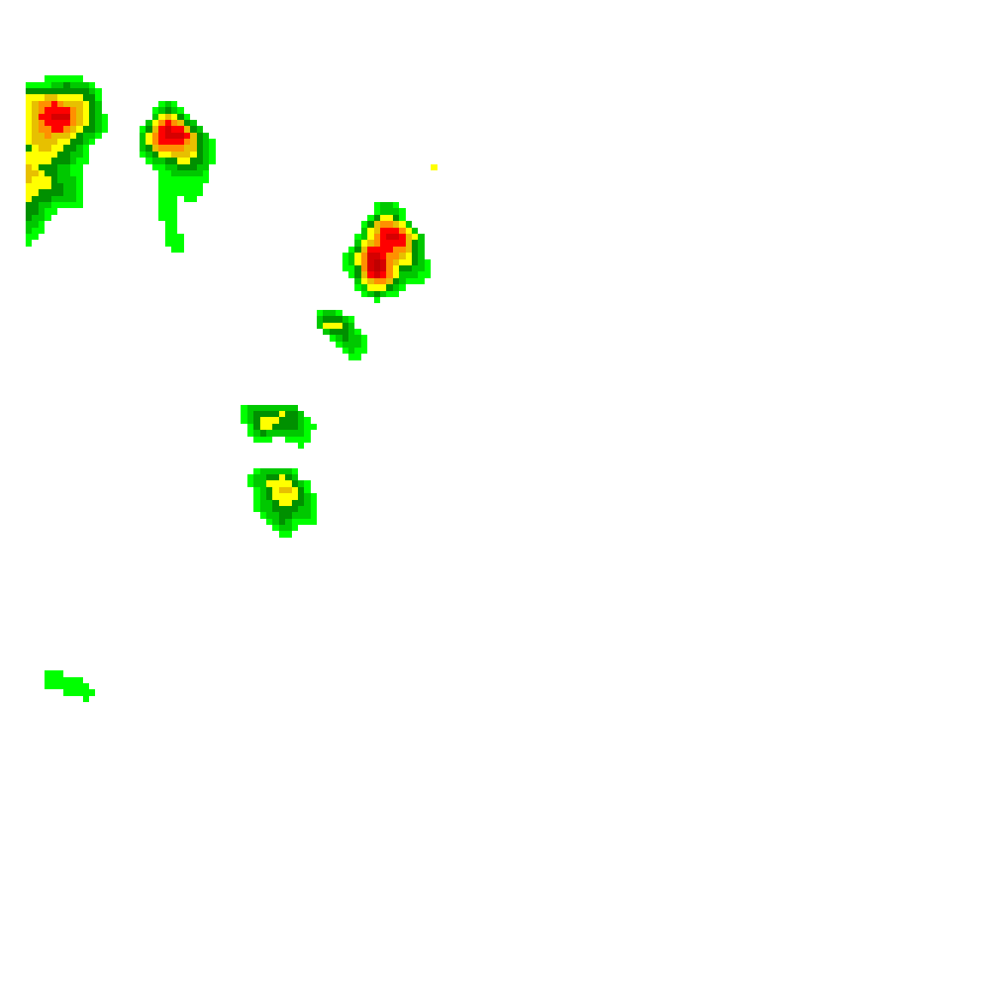

In [18]:
fig, ax = plt.subplots(dpi=300)
cmap = WoFSColors.nws_dz_cmap
levels = WoFSLevels.dz_levels_nws


z = targets.isel(time=0, batch=0, level=2)['COMPOSITE_REFL_10CM']
z = np.ma.masked_where(z < 10, z)
ax.imshow(z,
         cmap=cmap, origin='lower', vmax=70, vmin=10 )
ax.axis('off')

In [14]:
# Plot hodograph 
from metpy.plots import Hodograph 

fig, ax = plt.subplots()
hodo_plt = Hodograph(ax)

u = predictions['U'].isel(time=0, batch=0, lat=75, lon=75).values
v = predictions['V'].isel(time=0, batch=0, lat=75, lon=75).values
hgt = predictions['GEOPOT'].isel(time=0, batch=0, lat=75, lon=75).values

hodo_plt.add_grid()
hodo_plt.plot_colormapped(u,v,hgt)



ModuleNotFoundError: No module named 'metpy'

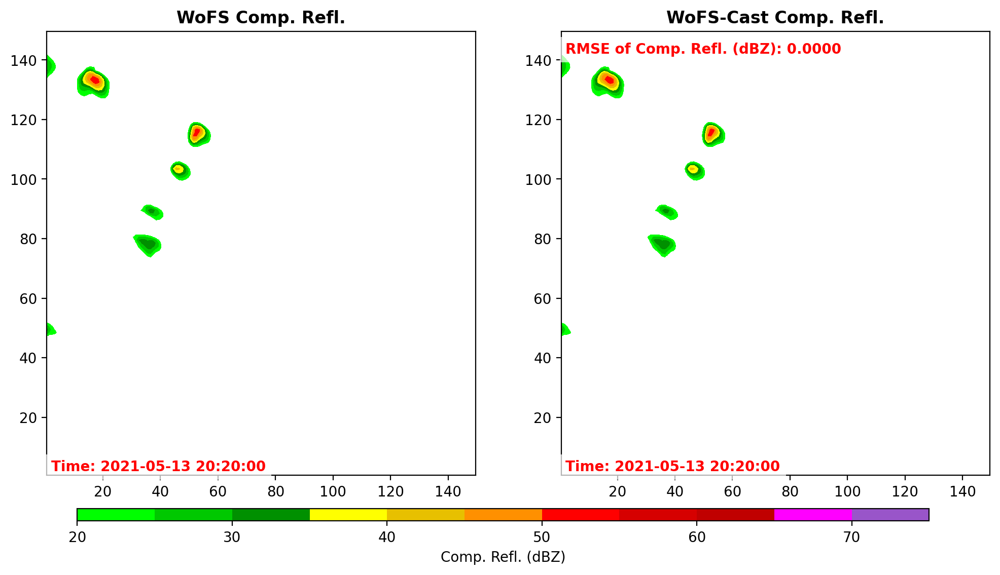

In [19]:
dts = to_datetimes(path, n_times = predictions.dims['time']+2)
animator = WoFSCastAnimator(domain_size=150, dts=dts)
anim = animator(
                #var='W', 
                #level='max',
                var = 'COMPOSITE_REFL_10CM',
                level='none',
    
                inputs=inputs, 
                predictions=predictions, 
                targets=targets, 
                #mrms_dz = mrms_dz
               )

# To display the animation in a Jupyter notebook
from IPython.display import HTML
HTML(anim.to_jshtml())

# Optionally, to save the animation
#anim.save("wofscast-idealized-warm-bubble.gif", writer="pillow", fps=3)   

In [10]:
anim.save("wofscast-idealized-warm-bubble.gif", writer="pillow", fps=3)  

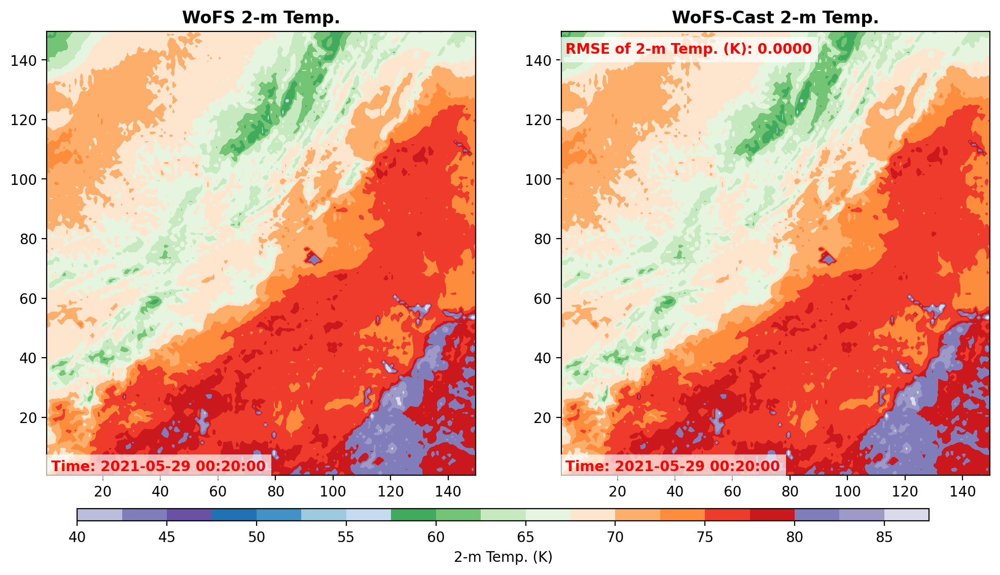

In [10]:
import matplotlib.pyplot as plt

# Increase the embed limit to 50 MB (or any value you prefer)
plt.rcParams['animation.embed_limit'] = 100  # Size in MB


dts = to_datetimes(path, n_times = predictions.dims['time']+2)
animator = WoFSCastAnimator(domain_size=150, dts=dts)
anim = animator(
                var='T2', 
                #level='max',
                #var = 'COMPOSITE_REFL_10CM',
                level='none',
    
                inputs=inputs, 
                predictions=predictions, 
                targets=targets, 
                #mrms_dz = mrms_dz
               )

# To display the animation in a Jupyter notebook
from IPython.display import HTML
#HTML(anim.to_jshtml())

# Optionally, to save the animation
anim.save("wofscast-33_hr_temp.gif", writer="pillow", fps=3)   

In [11]:
def compute_and_add_horizontal_divergence(dataset):
    """
    Computes horizontal convergence from the u and v wind components and adds it as a new variable to the dataset.
    
    Parameters:
    - dataset: xarray.Dataset with 'u' and 'v' wind components and coordinates (time, level, lat, lon)
    
    Returns:
    - dataset: xarray.Dataset with the computed horizontal convergence added as a new variable 'convergence'
    """
    # Extract the wind components
    u = dataset['U']
    v = dataset['V']
    
    # Compute the partial derivatives
    du_dx = u.differentiate('lon')  # Partial derivative of u with respect to longitude
    dv_dy = v.differentiate('lat')  # Partial derivative of v with respect to latitude
    
    # Compute divergence
    divergence = du_dx + dv_dy
    
    # Add convergence to the dataset
    dataset = dataset.assign(divergence=divergence)
    
    return dataset

In [12]:
predictions_with_div = compute_and_add_horizontal_divergence(predictions)

## Truth Cross-Sections

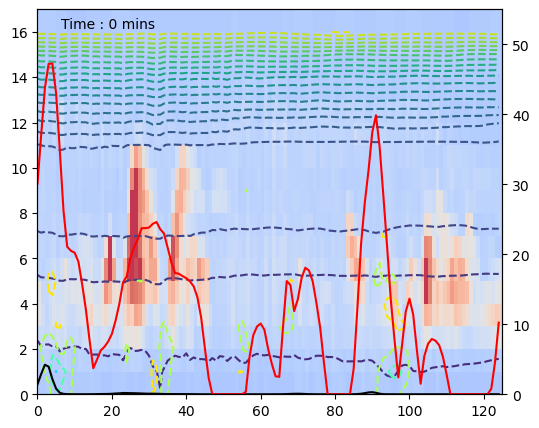

In [13]:
import matplotlib.colors as mcolors
lat = 80
# Plot cross-sections 
fig, ax = plt.subplots(dpi=100, figsize=(6,5))

ax_twin = ax.twinx()

lon_rng = np.arange(25,150)

targets_with_div = compute_and_add_horizontal_divergence(targets)

# Define boundaries and colormap
boundaries = np.linspace(np.percentile(targets['W'], 0.0001), np.percentile(targets['W'], 99.999), 100)
cmap = plt.get_cmap('coolwarm')

# Create a BoundaryNorm
norm = mcolors.BoundaryNorm(boundaries, cmap.N, extend='both')

div_levels = np.linspace(np.percentile(targets_with_div['divergence'], 0.0001), 
                         np.percentile(targets_with_div['divergence'], 99.999), 
                         10)
def update(t):
    ax.clear()
    ax_twin.clear()
    
    max_cross_section_ds = targets_with_div.isel(batch=0, time=t, lon=lon_rng).max(dim='lat')
    cross_section_ds = targets_with_div.isel(batch=0, time=t, lat=lat, lon=lon_rng)
    
    max_cross_section_ds = max_cross_section_ds.transpose('lon', 'level')
    cross_section_ds = cross_section_ds.transpose('lon', 'level')
    
    w_vals = max_cross_section_ds['W'].values
    cf = ax.pcolormesh(w_vals.T, norm=norm, cmap=cmap, alpha=0.8)#, levels=[-1.0, 2.5, 5, 10, 15])

    ax.contour(cross_section_ds['T'].T, linestyles='dashed', levels = np.linspace(250,650,25))

    x,y = cross_section_ds['lon'].values, cross_section_ds['level'].values
    #u,v = 
    
    #ax.quiver(x, y, u, v, alpha=0.5)
    
    cl = ax.contour(cross_section_ds['divergence'].T, linestyles='dashed', cmap='jet', levels=div_levels)
    
    ax_twin.plot(cross_section_ds['RAIN_AMOUNT'], color='k')
    ax_twin.plot(cross_section_ds['COMPOSITE_REFL_10CM'], color='r')
    ax_twin.set_ylim([0, 55])
    ax.annotate(f'Time : {t*10} mins', xy=(0.05, 0.95), xycoords='axes fraction')
    #ax_twin.set_ylabel('Rain Rate (in.)')
    
    
# Create the animation
ani = FuncAnimation(fig, update, frames=targets_with_div.dims['time'])

# To display the animation in a Jupyter notebook
HTML(ani.to_jshtml())

# Optionally, to save the animation
#ani.save("wofscast-cross-section_1.gif", writer="pillow", fps=3) 

## WoFSCast Cross-Sections

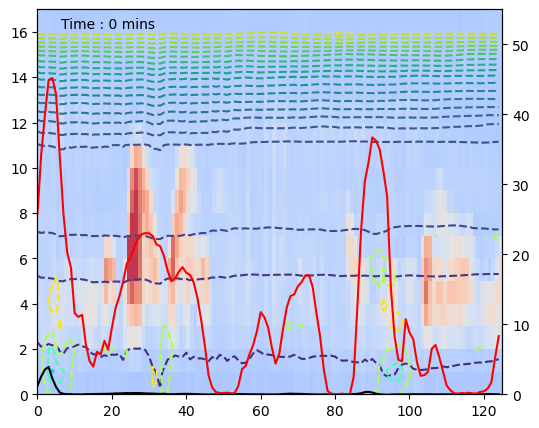

In [14]:
import matplotlib.colors as mcolors

# Plot cross-sections 
fig, ax = plt.subplots(dpi=100, figsize=(6,5))

ax_twin = ax.twinx()

lon_rng = np.arange(25,150)


# Define boundaries and colormap
boundaries = np.linspace(np.percentile(targets['W'], 0.0001), np.percentile(targets['W'], 99.999), 100)
cmap = plt.get_cmap('coolwarm')

# Create a BoundaryNorm
norm = mcolors.BoundaryNorm(boundaries, cmap.N, extend='both')

div_levels = np.linspace(np.percentile(targets_with_div['divergence'], 0.0001), 
                         np.percentile(targets_with_div['divergence'], 99.999), 
                         10)
def update(t):
    ax.clear()
    ax_twin.clear()
    
    max_cross_section_ds = predictions_with_div.isel(batch=0, time=t, lon=lon_rng).max(dim='lat')
    cross_section_ds = predictions_with_div.isel(batch=0, time=t, lat=lat, lon=lon_rng)
    
    max_cross_section_ds = max_cross_section_ds.transpose('lon', 'level')
    cross_section_ds = cross_section_ds.transpose('lon', 'level')
    
    w_vals = max_cross_section_ds['W'].values
    cf = ax.pcolormesh(w_vals.T, norm=norm, cmap=cmap, alpha=0.8)#, levels=[-1.0, 2.5, 5, 10, 15])

    ax.contour(cross_section_ds['T'].T, linestyles='dashed', levels = np.linspace(250,650,25))

    cl = ax.contour(cross_section_ds['divergence'].T, linestyles='dashed', cmap='jet', levels=div_levels)
    
    ax_twin.plot(cross_section_ds['RAIN_AMOUNT'], color='k')
    ax_twin.plot(cross_section_ds['COMPOSITE_REFL_10CM'], color='r')
    ax_twin.set_ylim([0, 55])
    ax.annotate(f'Time : {t*10} mins', xy=(0.05, 0.95), xycoords='axes fraction')
    #ax_twin.set_ylabel('Rain Rate (in.)')
    
    
# Create the animation
ani = FuncAnimation(fig, update, frames=predictions_with_div.dims['time'])

# To display the animation in a Jupyter notebook
HTML(ani.to_jshtml())

# Optionally, to save the animation
#ani.save("wofscast-cross-section_1.gif", writer="pillow", fps=3) 